In [1]:
import numpy as np
import pandas as pd

df = pd.read_csv('./OMUVBd_UV_EXT_URUGUAY.csv')

In [2]:
counts = df.groupby(['Latitude', 'Longitude']).size().reset_index(name='count')
counts = counts.set_index(np.arange(1, 1+len(counts)))


In [3]:

# df_filtered = df[(df['Latitude'] == -32.5) & (df['Longitude'] == -58.5)].reset_index()

df_filtered = df[
    (df['Mid_time'] >= '2004-12-21') & 
    (df['Mid_time'] <= '2025-12-31')
].reset_index()


# Ensure Mid_time is datetime
df_filtered['Mid_time'] = pd.to_datetime(df_filtered['Mid_time'])


year_counts = df_filtered.groupby(df_filtered['Mid_time'].dt.year).size().reset_index(name='count').shape[0]

df_filtered[['Latitude', 'Longitude', 'UVindex', 'CSUVindex', 'Mid_time']]


,Latitude,Longitude,UVindex,CSUVindex,Mid_time
0,-30.5,-53.5,13.754501,14.078314,2005-01-01 12:00:00+00:00
1,-33.5,-55.5,13.706107,13.961723,2005-01-01 12:00:00+00:00
2,-34.5,-58.5,12.398545,13.509786,2005-01-01 12:00:00+00:00
3,-35.5,-52.5,13.214313,13.513184,2005-01-01 12:00:00+00:00
4,-35.5,-53.5,13.157434,13.478663,2005-01-01 12:00:00+00:00
...,...,...,...,...,...
247833,-32.5,-55.5,3.533116,13.970057,2024-11-27 12:00:00+00:00
247834,-32.5,-54.5,3.257003,13.906936,2024-11-27 12:00:00+00:00
247835,-32.5,-52.5,8.030251,13.763735,2024-11-27 12:00:00+00:00
247836,-33.5,-54.5,2.503763,13.888719,2024-11-27 12:00:00+00:00


In [4]:
t_uv_index = 15.0
high_uv = df[df['CSUVindex'] > t_uv_index].reset_index()
high_uv[['Latitude', 'Longitude', 'UVindex', 'CSUVindex', 'Mid_time']].sort_values(by='CSUVindex')

counts = high_uv.groupby(['Latitude', 'Longitude']).size().reset_index(name='count')
counts

t = df[(df['Latitude'] == -30.5) & (df['Longitude'] == -54.5)].reset_index()
t = t[t['CSUVindex'] > t_uv_index].reset_index()
t

,level_0,index,CSErythemalDailyDose,CSErythemalDoseRate,CSIrradiance305,CSIrradiance310,CSIrradiance324,CSIrradiance380,CloudOpticalThickness,ErythemalDailyDose,...,Irradiance324,Irradiance380,LambertianEquivalentReflectivity,SolarZenithAngle,ViewingZenithAngle,CSUVindex,UVindex,Latitude,Longitude,Mid_time
0,31,1305,8275.795898,376.242157,115.718033,157.941559,490.075653,885.425842,9.327570,5074.532715,...,316.099609,553.231018,0.452830,28.741219,21.007294,15.047304,9.535865,-30.5,-54.5,2005-01-15 12:00:00+00:00
1,39,1672,8219.449219,376.934570,116.067619,157.507675,486.191345,878.199219,5.172623,6236.556152,...,383.272369,683.052612,0.264281,27.794149,8.769464,15.081533,11.739670,-30.5,-54.5,2005-01-24 12:00:00+00:00
2,693,29089,8293.346680,375.399658,115.271919,157.897415,491.419495,887.904663,5.380836,6214.005859,...,382.955139,681.923401,0.326461,24.000628,52.813366,15.022656,11.556943,-30.5,-54.5,2006-12-03 12:00:00+00:00
3,695,29185,8386.707031,379.228119,116.543251,158.912430,492.468994,889.202209,1.524628,7644.781738,...,457.660889,824.696411,0.157388,30.119999,64.597878,15.172980,14.023061,-30.5,-54.5,2006-12-05 12:00:00+00:00
4,707,29710,8490.461914,382.309723,117.501335,160.139130,496.047394,895.182190,35.586224,4287.359863,...,264.472839,465.915771,0.554056,24.779085,38.127274,15.290142,7.937113,-30.5,-54.5,2006-12-17 12:00:00+00:00
5,708,29721,8589.445312,386.724426,118.785347,160.985931,496.038391,894.914978,10.855225,5113.952148,...,310.311401,541.884033,0.503281,33.805164,39.923714,15.472948,9.504648,-30.5,-54.5,2006-12-18 12:00:00+00:00
6,709,29761,8468.175781,381.158875,117.060722,159.849716,496.009674,895.437439,1.382272,7806.782715,...,464.933105,837.743225,0.097802,21.978277,52.717541,15.255938,14.219945,-30.5,-54.5,2006-12-19 12:00:00+00:00
7,710,29827,8621.576172,388.116394,119.325302,161.468597,496.801331,895.858643,20.116848,4360.849121,...,264.889160,460.109650,0.558002,30.952482,20.040613,15.526667,8.097199,-30.5,-54.5,2006-12-20 12:00:00+00:00
8,711,29857,8525.801758,383.776459,117.870552,160.391388,496.114563,895.439697,1.852949,7639.760254,...,454.203644,817.011108,0.156201,27.953592,64.537582,15.357017,13.949495,-30.5,-54.5,2006-12-21 12:00:00+00:00
9,714,29996,8495.069336,382.429535,117.568413,160.305344,496.712219,896.380981,51.336292,1781.790894,...,115.470673,190.872940,0.859859,25.322321,28.556767,15.293468,3.293437,-30.5,-54.5,2006-12-24 12:00:00+00:00


In [5]:
import pandas as pd
import plotly.offline as pyo
import plotly.graph_objects as go

# assume df_filtered already has:
#   Mid_time (datetime), UVindex, CSUVindex, Season

pyo.init_notebook_mode(connected=True)

# Ensure Mid_time is datetime
df_filtered['Mid_time'] = pd.to_datetime(df_filtered['Mid_time'])

# Define South American seasons
def get_season(date):
    """
    South Hemisphere seasons with non‐overlapping boundaries:
      – Verano    (Summer):   Dec 21 – Mar 20
      – Otoño     (Autumn):   Mar 21 – Jun 20
      – Invierno  (Winter):   Jun 21 – Sep 22
      – Primavera (Spring):   Sep 23 – Dec 20
    Labels season by the year in which most of it falls.
    """
    # Month‐day integer for easy comparison
    mmd = date.month * 100 + date.day
    y = date.year

    # Summer: Dec 21 (1221)–Dec 31 or Jan 1–Mar 20 (  101– 320)
    if mmd >= 1221 or mmd <= 320:
        year_label = y + 1 if mmd >= 1221 else y
        return f"Verano {year_label}"
    # Autumn: Mar 21 (321)–Jun 20 (620)
    if 321 <= mmd <= 620:
        return f"Otoño {y}"
    # Winter: Jun 21 (621)–Sep 22 (922)
    if 621 <= mmd <= 922:
        return f"Invierno {y}"
    # Spring: Sep 23 (923)–Dec 20 (1220)
    return f"Primavera {y}"



df_filtered['Season'] = df_filtered['Mid_time'].apply(get_season)
df_filtered = df_filtered.sort_values('Mid_time')

# build figure
fig = go.Figure()

# UVindex line + hover
# fig.add_trace(go.Scatter(
#     x=df_filtered['Mid_time'],
#     y=df_filtered['UVindex'],
#     mode='lines',
#     name='UVindex',
#     line=dict(color='darkorange', width=0.5),
#     hovertemplate=
#         "Date: %{x|%Y-%m-%d}<br>" +
#         "UVindex: %{y:.2f}<extra></extra>"
# ))

# CSUVindex line + hover
fig.add_trace(go.Scatter(
    x=df_filtered['Mid_time'],
    y=df_filtered['CSUVindex'],
    mode='lines',
    name='CSUVindex',
    line=dict(color='royalblue', width=0.5),
    customdata=df_filtered[['Latitude', 'Longitude']],
    hovertemplate=
        "Date: %{x|%Y-%m-%d}<br>" +
        "CSUVindex: %{y:.2f}<br>" +
        "Lat: %{customdata[0]:.2f}, Lon: %{customdata[1]:.2f}<extra></extra>"
))

t_uv_index = 15.5
fig.add_hline(
    y=t_uv_index,
    line=dict(color="red", width=1, dash="dash"),
    opacity=0.3,
    annotation_text=f"CSUVindex = {t_uv_index}",
    annotation_position="top left",
    annotation_font_color="red"
)

# high_uv = df_filtered[df_filtered['CSUVindex'] > t_uv_index]

# fig.add_trace(go.Scatter(
#     x=high_uv['Mid_time'],
#     y=high_uv['CSUVindex'],
#     mode='markers',
#     marker=dict(symbol='x', color='red', size=4),
#     name=f'UV > {t_uv_index}',
#     hovertemplate="Date: %{x|%Y-%m-%d}<br>threshold CSUVindex: %{y:.2f}<extra></extra>"
# ))



# print("Max UVindex:", df_filtered['CSUVindex'].max())
# print("Points > threshold:", len(high_uv))

# add Verano start/end verticals
starts = df_filtered.loc[
    (df_filtered['Season'].str.startswith('Verano')) &
    (~df_filtered['Season'].shift().str.startswith('Verano', na=False)),
    'Mid_time'
]
ends = df_filtered.loc[
    (~df_filtered['Season'].str.startswith('Verano')) &
    (df_filtered['Season'].shift().str.startswith('Verano', na=False)),
    'Mid_time'
]
for t in starts:
    fig.add_vline(x=t, line=dict(color='firebrick', dash='dash'))
for t in ends:
    fig.add_vline(x=t, line=dict(color='firebrick', dash='dash'))

# x‐axis ticks per season
ticks = df_filtered.drop_duplicates('Season')[['Mid_time','Season']]
fig.update_xaxes(
    tickmode='array',
    tickvals=ticks['Mid_time'],
    ticktext=ticks['Season'],
    tickangle=45
)

fig.update_layout(
    title="UVindex & CSUVindex Over Time",
    xaxis_title="Season and Year",
    yaxis_title="Index value",
    hovermode='x unified',
    template='seaborn',
    width=year_counts*500, height=500
)

pyo.iplot(fig)


In [6]:
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objects as go

pyo.init_notebook_mode(connected=True)

def points_at(lat, lon):
    return high_uv[(high_uv['Latitude'] == lat) & (high_uv['Longitude'] == lon)].reset_index()[['CSUVindex']]

t_uv_index = 15.0

high_uv = df[df['CSUVindex'] > t_uv_index].reset_index()

# Count per coordinate
counts = high_uv.groupby(['Latitude', 'Longitude']).size().reset_index(name='count')
high_uv = high_uv.merge(counts, on=['Latitude', 'Longitude'], how='left')

high_uv['Mid_time'] = pd.to_datetime(high_uv['Mid_time'])

# 1) aggregate mean & count by (lat,lon)
agg = (
    high_uv
    .groupby(['Latitude','Longitude'])
    .agg(
        mean_CSUV=('CSUVindex','mean'),
        min_CSUV=('CSUVindex','min'),
        max_CSUV=('CSUVindex','max'),
        count=('CSUVindex','size'),
        sample_date=('Mid_time','first')
    )
    .reset_index()
)

# 2) use agg in Scattermapbox
fig = go.Figure()
fig.add_trace(go.Scattermapbox(
    lat=agg['Latitude'],
    lon=agg['Longitude'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=agg['count'],
        color=agg['mean_CSUV'],
        colorscale='YlOrRd',
        showscale=True
    ),
    customdata=agg[['count','mean_CSUV','min_CSUV','max_CSUV']],
    hovertemplate=(
        "Lat: %{lat:.2f}, Lon: %{lon:.2f}<br>"
        "CSUVindex: %{customdata[2]:.2f} - %{customdata[3]:.2f}<br>"
        "CSUVindex Mean: %{customdata[1]:.2f}<br>"
        "Frequency: %{customdata[0]}<extra></extra>"
    ),
    text=agg['sample_date'].dt.strftime('%Y-%m-%d')
))


fig.update_layout(
    mapbox=dict(
        style="open-street-map",
        zoom=5.5,
        center=dict(lat=high_uv['Latitude'].mean(), lon=high_uv['Longitude'].mean())
    ),
    margin={"r": 0, "t": 30, "l": 0, "b": 0},
    title=f'CSUVindex > {t_uv_index}'
)

pyo.iplot(fig)


/var/folders/08/5rdlnpvd5pq2fc82f0hcxt980000gn/T/ipykernel_29735/3434714723.py:36: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



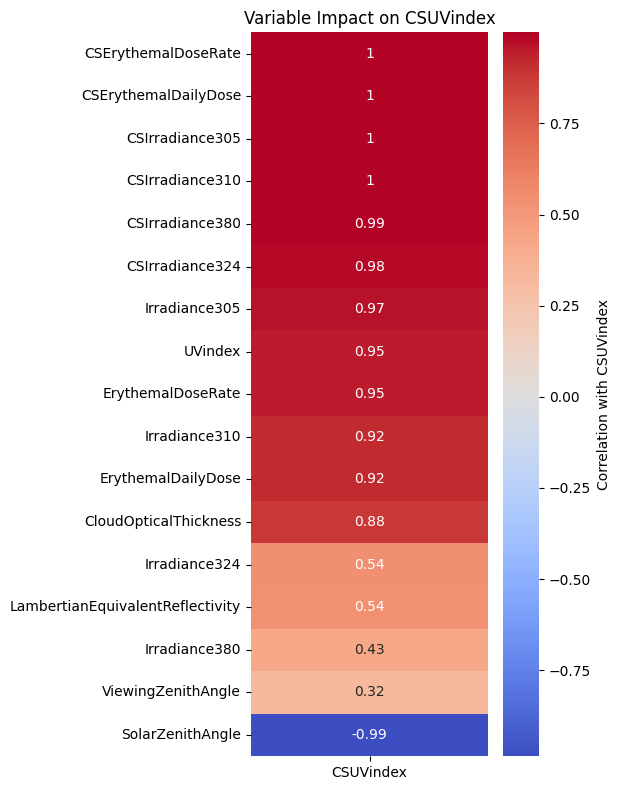

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Recreate df_mean
df_mean = (
    df[['CSErythemalDailyDose', 'CSErythemalDoseRate', 'CSIrradiance305',
        'CSIrradiance310', 'CSIrradiance324', 'CSIrradiance380',
        'CloudOpticalThickness', 'ErythemalDailyDose', 'ErythemalDoseRate',
        'Irradiance305', 'Irradiance310', 'Irradiance324', 'Irradiance380',
        'LambertianEquivalentReflectivity', 'SolarZenithAngle',
        'ViewingZenithAngle', 'CSUVindex', 'UVindex',
        'Latitude', 'Longitude']]
    .groupby(['Latitude', 'Longitude'], as_index=False)
    .mean()
)

df_mean = df_mean.drop(['Latitude', 'Longitude'], axis=1)

# compute correlation matrix
corr = df_mean.corr()

# extract correlations with CSUVindex
corr_csuv = corr[['CSUVindex']].drop('CSUVindex').sort_values('CSUVindex', ascending=False)

plt.figure(figsize=(6, 8))
sns.heatmap(
    corr_csuv,
    annot=True,
    cmap='coolwarm',
    center=0,
    cbar_kws={'label': 'Correlation with CSUVindex'}
)
plt.yticks(rotation=0)
plt.title('Variable Impact on CSUVindex')
plt.tight_layout()
plt.show()